In [1]:
import os
import random
import spacy
import ast
import glob
import spacy
import openai
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx
import hdbscan
import module


from collections import defaultdict
from umap.umap_ import UMAP
from itertools import combinations
from matplotlib.colors import ListedColormap
from tqdm.auto import tqdm
from langdetect import detect, DetectorFactory
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from scipy.stats import gaussian_kde


# Input

In [2]:
external = pd.read_csv('exp/external.csv')
internal = pd.read_csv('exp/internal.csv')

# converts lists and dictionaries in the columns
external = module.eval_as(external)
internal = module.eval_as(internal)

In [3]:
external.sample()

,Z30_CALL_NO,frequency,users,users_weighed,yearly_frequency,yearly_loan_time,title,is_outlier,yearly_frequency_norm,frequency_norm
24807,Dt 1470-5720,1,[E-183],[E-183],{2015: 1},{2015: 1.0},La dï¿½coration de la Chapelle de S. Gaetan de...,False,"{2015: 0.00909090909090909, 2013: 0.0, 2014: 0...",0.0


# Embedding 

/Users/hana/anaconda3/envs/bhviz/lib/python3.10/site-packages/umap/umap_.py:1879: UserWarning: gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable
  warn(
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


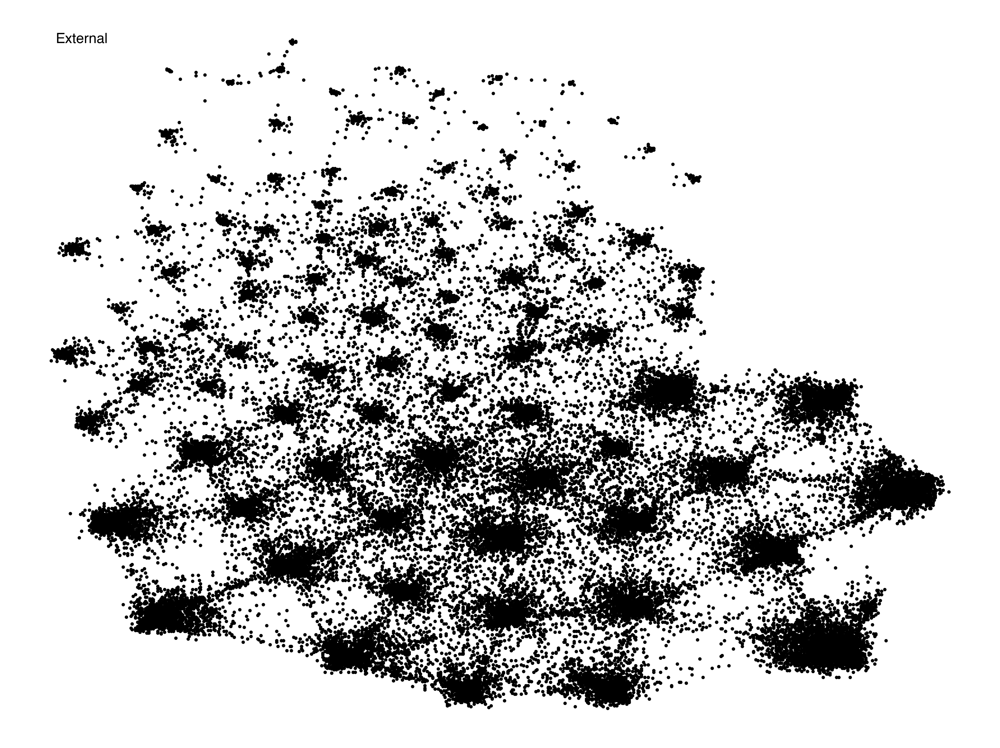

/Users/hana/anaconda3/envs/bhviz/lib/python3.10/site-packages/umap/umap_.py:1879: UserWarning: gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable
  warn(


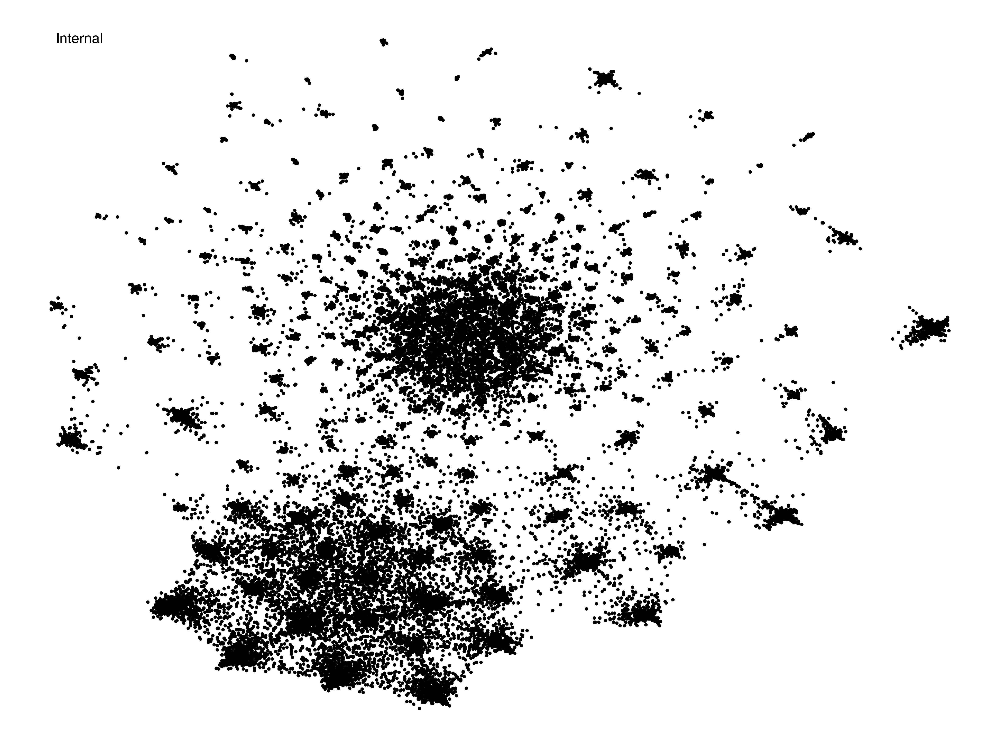

In [4]:
# Identity tokenizer for tfidf
def identity_tokenizer(doc):
    return doc

# TFIDF and Embedding for a df
def embedding(df, title): 

    tfidf = TfidfVectorizer(tokenizer = identity_tokenizer, preprocessor= identity_tokenizer, token_pattern=None)
    users_weighed_tfidf = tfidf.fit_transform(df['users_weighed'])

    reducer = UMAP(n_components=2, metric='hamming', n_neighbors=50)
    emb = reducer.fit_transform(users_weighed_tfidf)

    scaler = MinMaxScaler(feature_range=(100, 900))  # Scale
    emb = scaler.fit_transform(emb)
    emb = emb.astype(int)
    module.plot_embedding(emb,title)

    df = df.assign(x=emb[:, 0], y=emb[:, 1])
    return df

def clustering(df): 
    
    hdb = hdbscan.HDBSCAN(
    # min_samples=1,
    min_cluster_size=20,  # 2 — which means 3 elements — is the smallest cluster size
    cluster_selection_epsilon=5,   # float, optional (default=0.0) A distance threshold. Clusters below this value will be merged.
    # gen_min_span_tree=False,
    # leaf_size=10, # int, optional (default=40) If using a space tree algorithm (kdtree, or balltree) the number of points ina leaf node of the tree. This does not alter the resulting clustering, but may have an effect on the runtime of the algorithm.
)
    embedding = df[['x', 'y']].to_numpy()
    hdb.fit(embedding)
    clusters = hdb.labels_

    df['cluster'] = clusters

    return df,hdb

external = embedding(external, 'External')
internal = embedding(internal, '')

external, ext_hdb = clustering(external)
internal, int_hdb = clustering(internal)





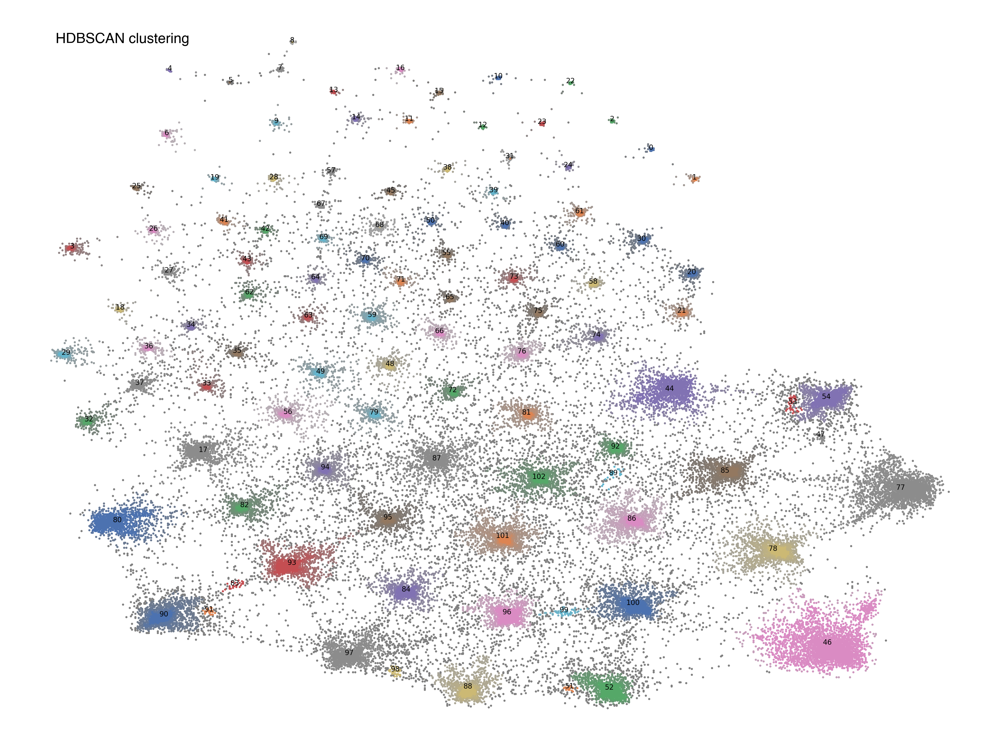

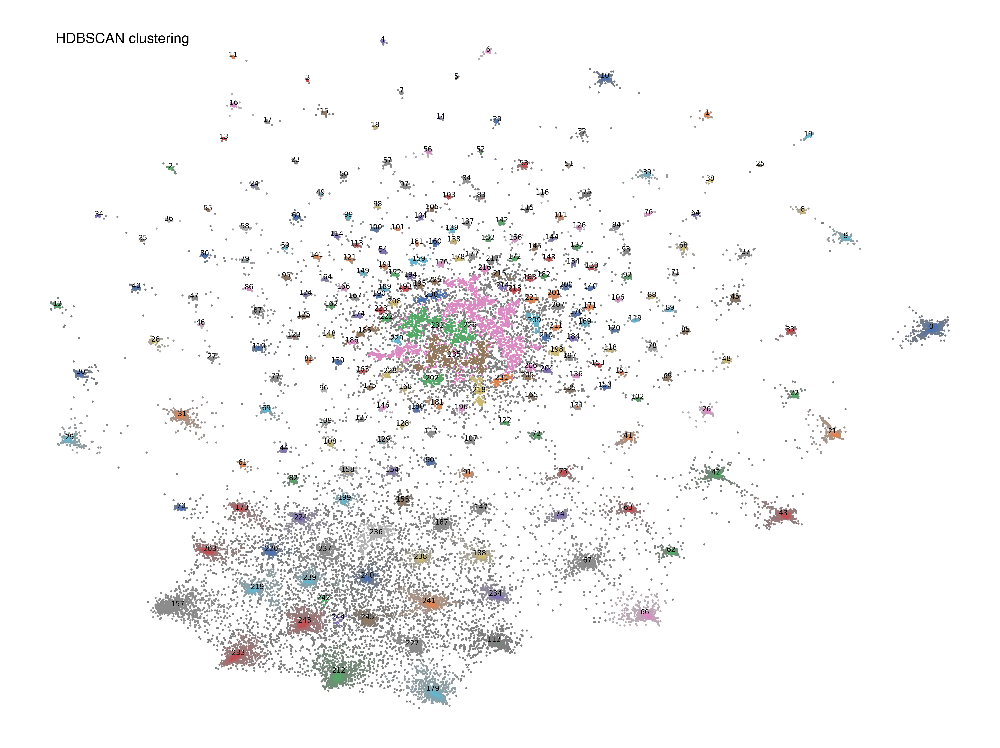

In [5]:
module.plot_clustering(external, ext_hdb)
module.plot_clustering(internal, int_hdb)

# Analysis

In [6]:
# Full bvb export for metadata
path = '../../data/hertziana_exp/b3kat_export/'
files = glob.glob(os.path.join(path, '*.csv'))

li = []

for filename in files: 
    frame = pd.read_csv(filename, header=0)
    li.append(frame)

df_full = pd.concat(li, axis=0, ignore_index=True)

df_full= df_full[['id', 'lang', 'authors', 'parentId', 'title', 'subtitle', 'statement']] # Select columns here
df_full = df_full.drop_duplicates(subset=['id'])

external = external.merge(df_full, left_on='title', right_on='title', how='left')
external = external.drop_duplicates(subset=['Z30_CALL_NO'])

internal = internal.merge(df_full, left_on='title', right_on='title', how='left')
internal = internal.drop_duplicates(subset=['Z30_CALL_NO'])

/var/folders/fs/xb9k_3m95gq0wjgk1kgw1nxr0000gn/T/ipykernel_3150/1359609313.py:8: DtypeWarning: Columns (12,13) have mixed types. Specify dtype option on import or set low_memory=False.
  frame = pd.read_csv(filename, header=0)


In [7]:
external_clustered = external[external['cluster'] != -1]
internal_clustered = internal[internal['cluster'] != -1]

/var/folders/fs/xb9k_3m95gq0wjgk1kgw1nxr0000gn/T/ipykernel_3150/3369979605.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  external_clustered['Subject'] = external_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
/Users/hana/Documents/GitHub/BHVizData/thesis/src/module.py:146: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(x_values, y_values, s=2, c=color)


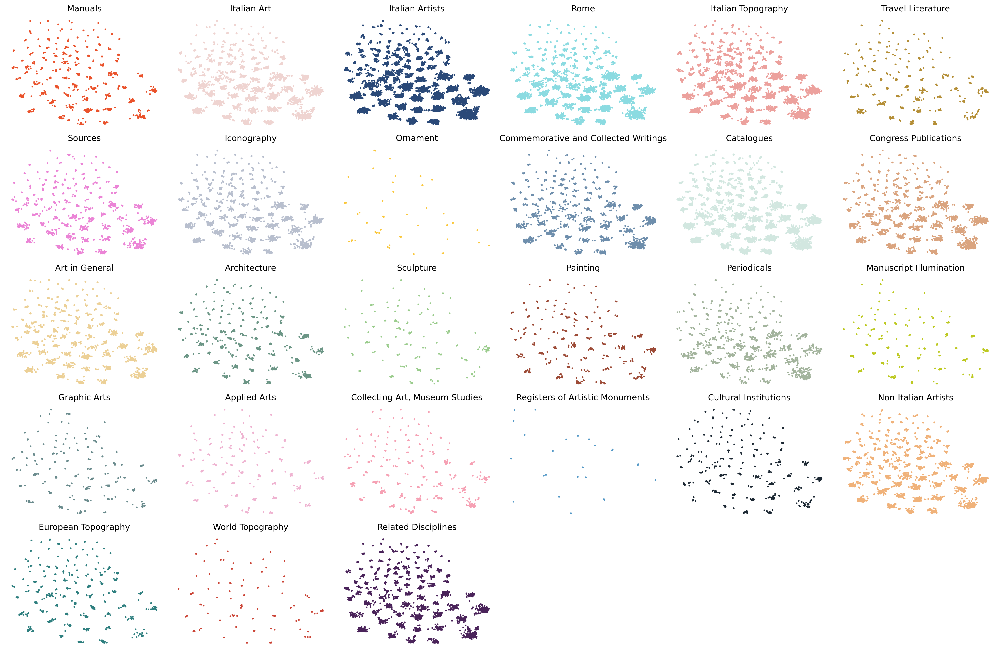

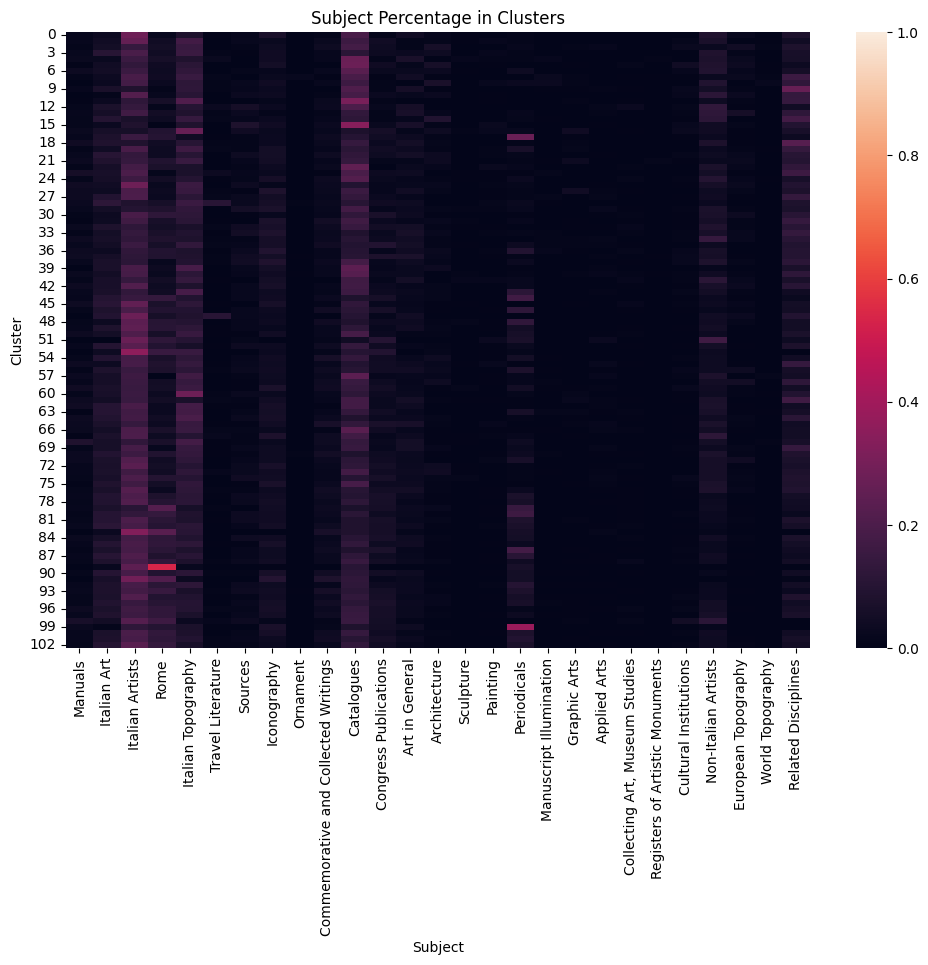

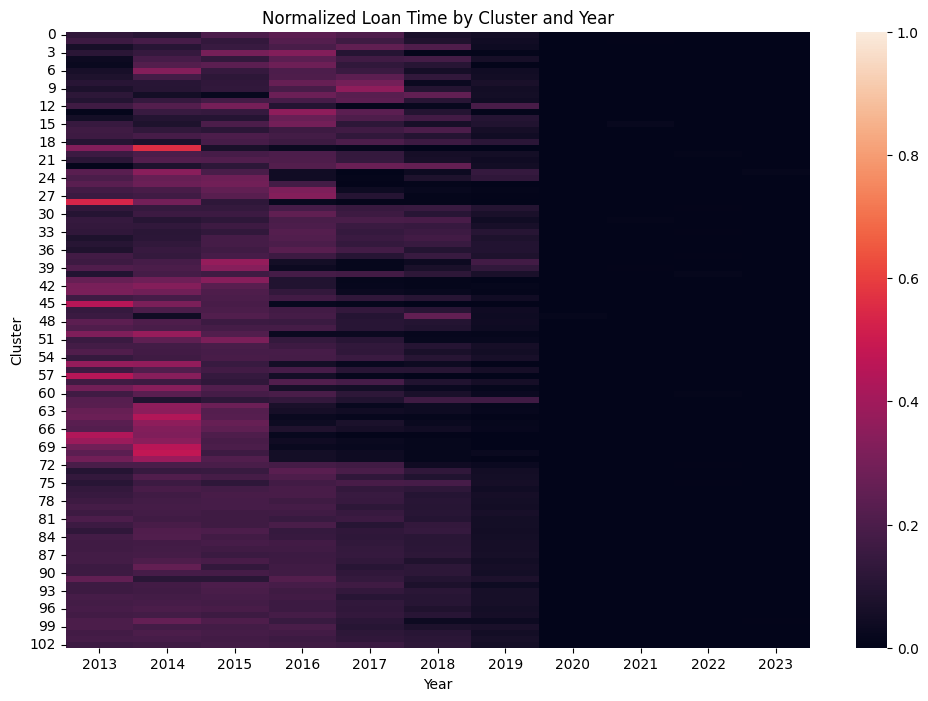

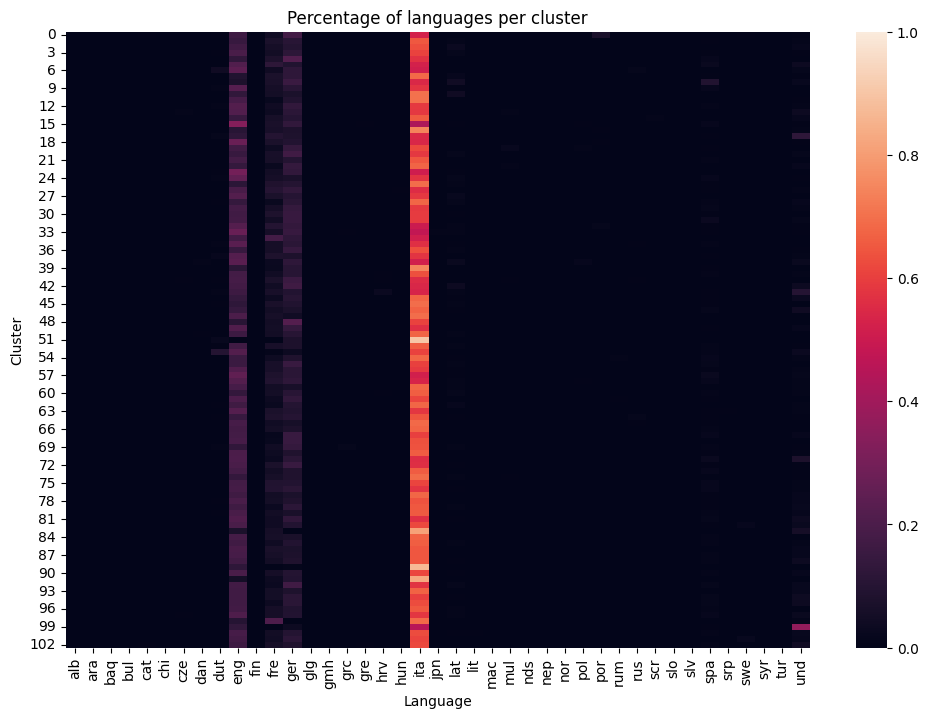

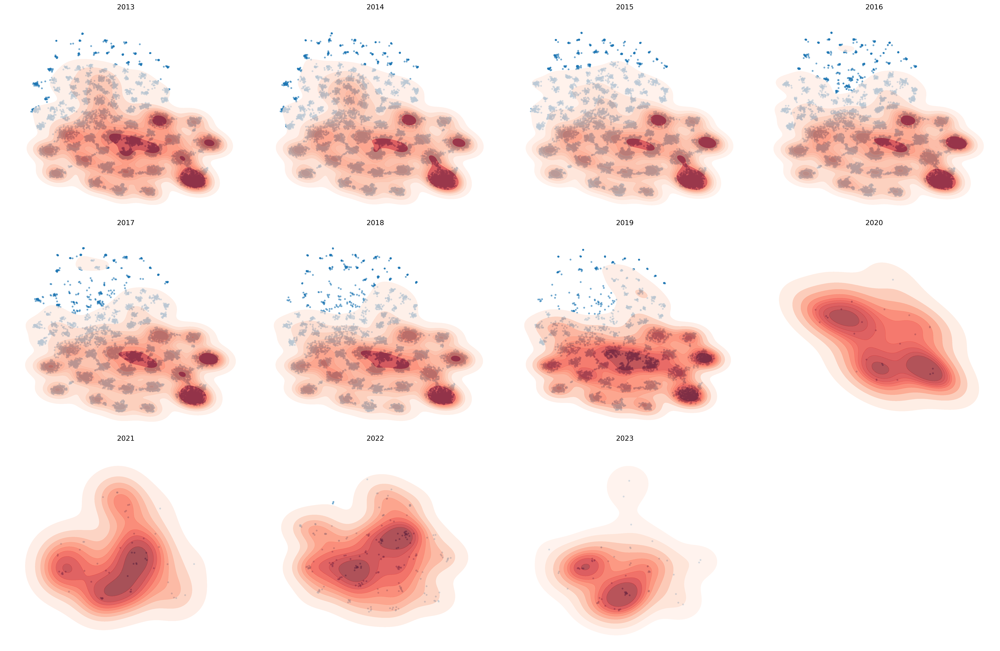

In [8]:
external_clustered['Subject'] = external_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
module.small_multiple_subject(external_clustered)
module.subject_heatmap(external_clustered)
module.temporality_heatmap(external_clustered)
module.language_heatmap(external_clustered)
module.plot_loan_density(external_clustered)

/var/folders/fs/xb9k_3m95gq0wjgk1kgw1nxr0000gn/T/ipykernel_3150/1015415126.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  internal_clustered['Subject'] = internal_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
/Users/hana/Documents/GitHub/BHVizData/thesis/src/module.py:146: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(x_values, y_values, s=2, c=color)


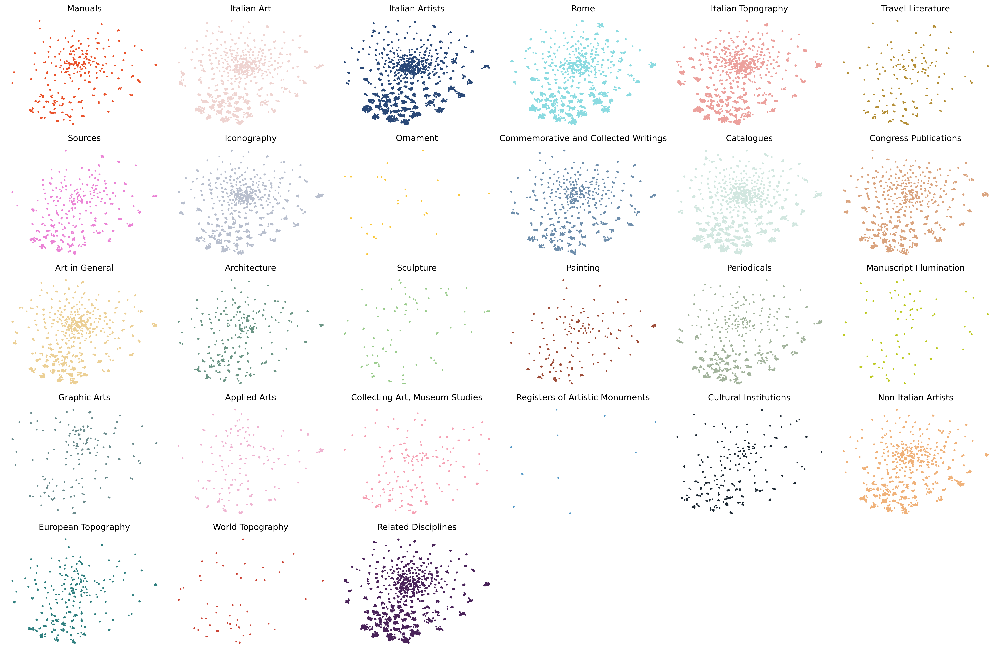

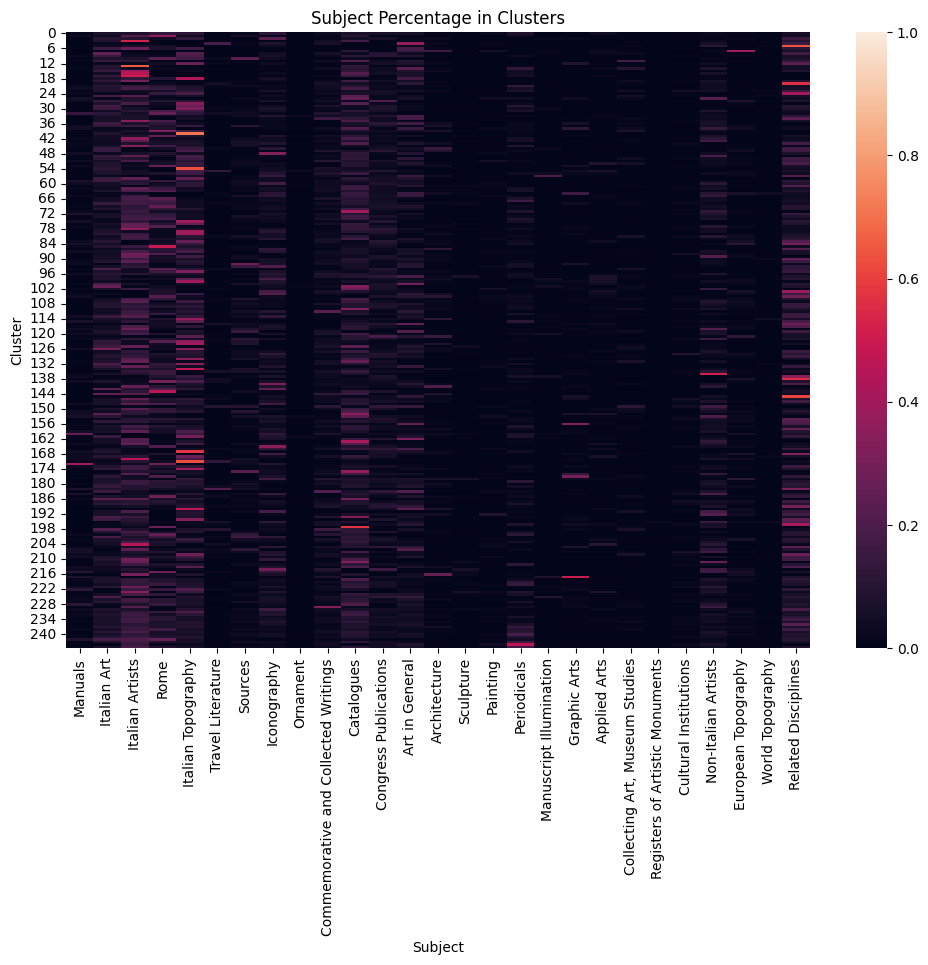

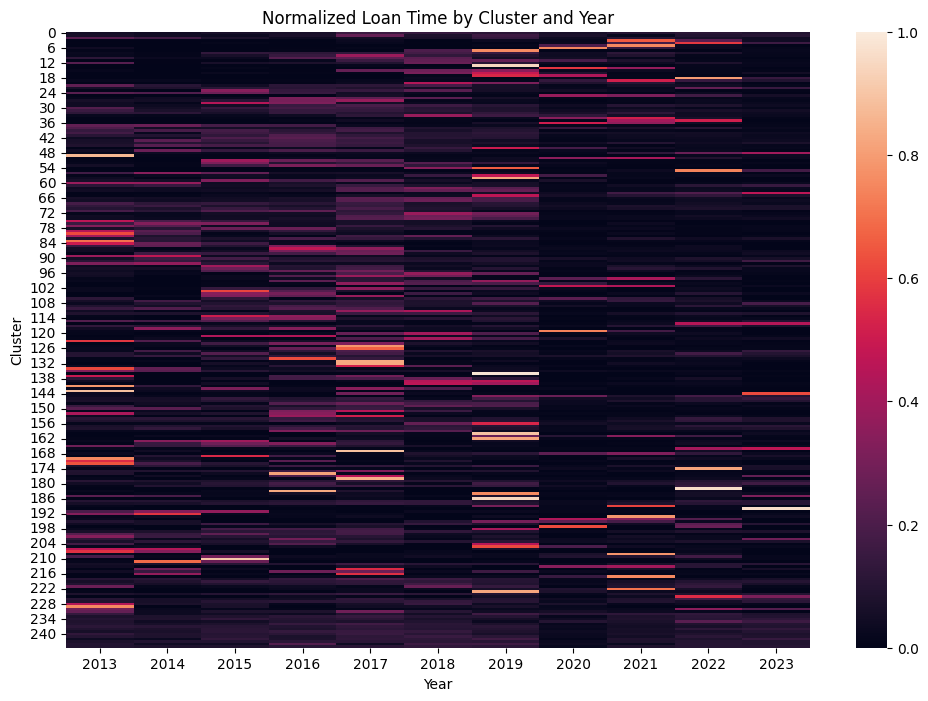

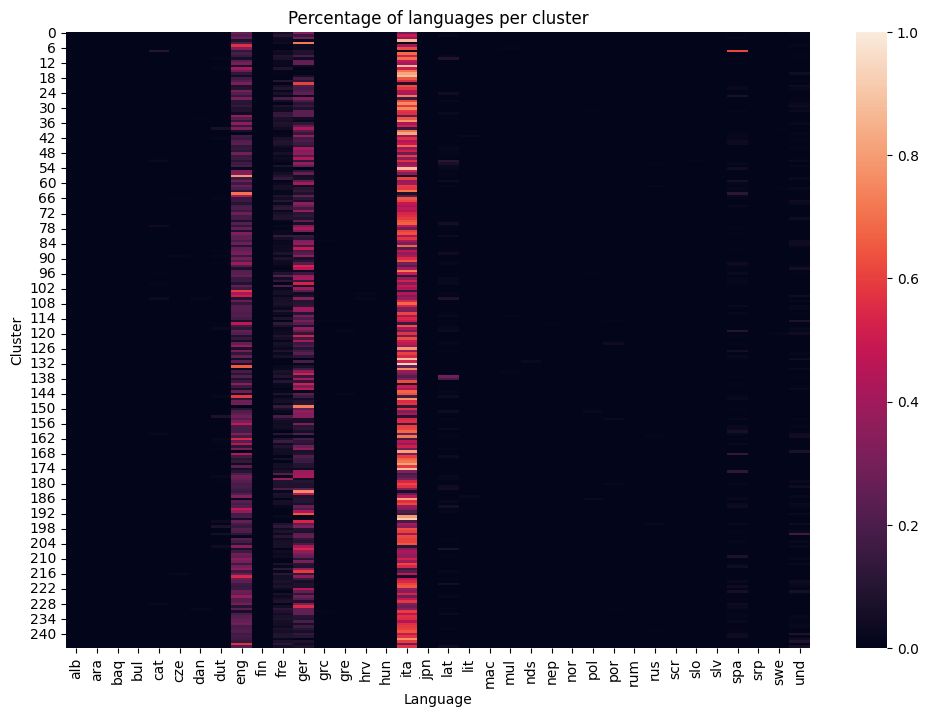

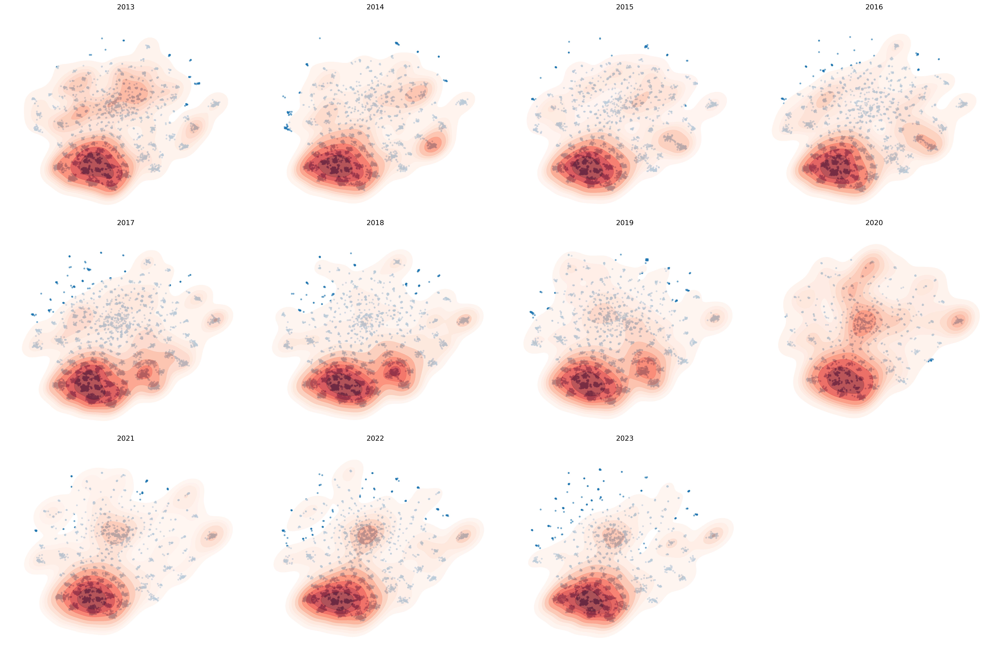

In [9]:
internal_clustered['Subject'] = internal_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
module.small_multiple_subject(internal_clustered)
module.subject_heatmap(internal_clustered)
module.temporality_heatmap(internal_clustered)
module.language_heatmap(internal_clustered)
module.plot_loan_density(internal_clustered)

# Export titles and clusters 

In [10]:
def to_cluster_df(df):
    cluster_numbers = []
    cluster_xs = []
    cluster_ys = []
    cluster_users = []
    cluster_size = []
    cluster_books = []
    cluster_titles = []


    for cluster_number in np.unique(df.cluster.unique()):
        if cluster_number == -1:
            continue  # Skip outliers which are labelled as -1
        
        cluster_indices = np.where(df.cluster== cluster_number)[0]
        rows = df.iloc[cluster_indices]   
        cluster_x = rows['x'].mean()
        cluster_y = rows['y'].mean()
        users = rows['users'].explode().unique().tolist()
        size = len(users)
        titles = ','.join(rows['title'])
        books = len(rows)


        cluster_numbers.append(cluster_number)
        cluster_xs.append(cluster_x)
        cluster_ys.append(cluster_y)
        cluster_users.append(users)
        cluster_size.append(size)
        cluster_titles.append(titles)
        cluster_books.append(books)


    clusters_df = pd.DataFrame({
        'cluster': cluster_numbers,
        'x': cluster_xs,
        'y': cluster_ys,
        'users': cluster_users, 
        'nr_users': cluster_size, 
        'nr_books': cluster_books,
        'titles': cluster_titles
    })

    return clusters_df

clusters_i = to_cluster_df(internal_clustered)
clusters_e = to_cluster_df(external_clustered)

In [11]:
clusters_i.to_csv('exp/clusters_i.csv', index=False)
clusters_e.to_csv('exp/clusters_e.csv', index=False)

In [12]:
internal.to_csv('../../../BHVizApp/src/data/internal_embedding.csv', index=False)